# Exploring Microsoft Thoughout the Years: NER on 10-K Filings




## Objective
In this project, we are interested in learning how a company changes over time in respect to it's competitors and the types of products and services it provides. In this particular case, we will be analyzing Microsoft throughout the years from 1994 through the current year (2019).



# Process
- Gather
  - SEC.gov
- Load
  - TXT
  - HTML
- Mine/Extract
- Analyze
  - Tabular
  - Network Graph

## Gather: Flat File Import

Files prior to 2002 from Microsoft were in TXT format. We can download and perform a flat file import.
> _Could have gathered data through API calls. However, due to the scope of the project, it was easier to download the necessary files._

In [1]:
# initial libraries

import numpy as np
import pandas as pd
import operator as op
import string
import re
import matplotlib.pyplot as plt
import seaborn as sns
import nltk

sns.set_style('darkgrid')
%config InlineBackend.figure_format ='retina'

In [2]:
# import filings which are in *.txt format
# on local drive

import os
from os import listdir, getcwd
from os.path import isfile, join

currentDirectory = os.getcwd()+'//dataset'
onlyfiles = [f for f in listdir(currentDirectory) if isfile(join(currentDirectory, f))]
txtfiles = [f for f in onlyfiles if re.match(r'.+.txt', f) != None]

In [3]:
# text file collections

txtfiles

['msft-10k_19940630.txt',
 'msft-10k_19950630.txt',
 'msft-10k_19960630.txt',
 'msft-10k_19970630.txt',
 'msft-10k_19980630.txt',
 'msft-10k_19990630.txt',
 'msft-10k_20000630.txt',
 'msft-10k_20010630.txt']

## Functions for Preprocessing

Functions are created for preprocessing the text.

- tokenize
- remove stop words, symbols and numbers
- lemmatize

In [4]:
# nltk imports
from nltk.corpus import stopwords
from nltk.stem import WordNetLemmatizer

# spacy stopwords
from spacy.lang.en import stop_words as spacy_stopwords

# initialize stopwords
nltk_stopwords = stopwords.words('english')

# initialize lemmatizer
nltk_lemma = WordNetLemmatizer()

# import word tokenizer
from nltk.tokenize import word_tokenize, sent_tokenize

# sklearn stopwords
from sklearn.feature_extraction.stop_words import ENGLISH_STOP_WORDS as sklearn_stopwords

all_stopwords = set(nltk_stopwords + list(sklearn_stopwords) + list(spacy_stopwords.STOP_WORDS))

# symbols
add_symbols = ['***', '**', '...', '•']
all_symbols = ' '.join(string.punctuation).split(' ') + add_symbols

### Sentence Tokens

By using sentence tokens, we can figure out sections of the document.

In [5]:
def clean_sent_token(text):
    
    # replace unwanted text
    replaced = text.replace('\n', ' ')
    
    # apply sentence tokenizer from nltk
    tokenized = sent_tokenize(replaced)
    
    cleaned = tokenized # not needed, but may process tokens in the future
    
    return cleaned

### Word Tokens

By using word tokens, we can identify topics, keywords, and organizations.

In [6]:
def clean_text_token(text):
    
    # first, replace new line character with space
    replaced = text.replace('\n', ' ').lower()
    
    # second, apply word_tokenizer from nltk
    tokenized = word_tokenize(replaced)
    
    # lemmatize and remove stopwords and punctuations and numbers
    cleaned = [nltk_lemma.lemmatize(word)
               for word in tokenized 
               if (word not in all_stopwords) & 
                   (word not in all_symbols) & 
                   (word.isalpha())]
    
    return cleaned

### Read and Preprocess (TXT)

In [7]:
# nltk.download('punkt')

years = []
filings = []

for f in txtfiles:
    
    # filing year
    years.extend(re.findall(r'20\d{2}|19\d{2}', f))
    
    # open file
    file = open('dataset/'+f, mode='r')
    file_clean = clean_sent_token(file.read())

    # Print it
    filings.append(file_clean)

    # close file
    file.close()

In [8]:
print(f'Filing years: {years}\n')
print(f'Number of Filings: {len(filings)}')

Filing years: ['1994', '1995', '1996', '1997', '1998', '1999', '2000', '2001']

Number of Filings: 8


## Corpus Scoping (TXT)
- Part I
  - Products and Services
  - Competitors
  - Employees

## Scoping
> Text file is unstructured. However, we can identify sections of interest using specific patterns and words.

In [9]:
# we can scope by viewing manually since we only have eight text files
# we will use regex to get the specific range

range1_start , range1_end = (18, 23) 
range2_start , range2_end = (200, 550) 

for filing in filings:
    print('------------------------------------------------------------------------------\n',filing[18:23]) # providing initial range for locating PART I
    print('------------------------------------------------------------------------------\n',filing[200:550], '\n\n') # providing range to locate PART II

ing Microsoft, he was Managing Director and co-head of Technology and Telecommunications Advisory Services at international investment bank Lazard Freres & Co. LLC.', 'He spent 12 years in San Francisco and New York with Lazard and Morgan Stanley, specializing in advising clients in the technology and telecommunications sectors on mergers, acquisitions, and strategic partnerships.', 'Mr. Flessner was named Senior Vice President, .NET Enterprise Servers in December 1999.', 'He had been Vice President, Database and Data Access.', "Since joining the Company, Mr. Flessner's primary responsibilities have been the development of Microsoft's database business.", 'He assumed responsibility for the engineering of Microsoft SQL Server in 1995.', 'He joined Microsoft in 1994.', 'Mr. Johnson was named Senior Vice President, U.S.', 'Sales, Marketing, and Services in August 2001.', 'He had been Vice President, U.S.', 'Sales, Marketing and Services.', 'Mr. Johnson was named Vice President, Product Su

In [10]:
# search using similar identifiers across corpus

# patterns between PART I and PART II
pattern_item1 = re.compile(r'part\s+i\s+item\s+1', re.I) # look for 'PART I Item 1'
pattern_item5 = re.compile(r'part\s+ii\s+item\s+5', re.I) # look for 'PART II Item 5'

# patterns within PART I
pattern_competition = re.compile(r'COMPETITION|Competition\s\s+|Competition\s-+') # look for 'Competition'
pattern_employees = re.compile(r'EMPLOYEES|Employees\s\s+|Employees\s-+') # look for 'Employees'
pattern_executives = re.compile(r'EXECUTIVE\sOFFICERS', re.I) # look for 'Executive Officers '

# store our corpus in list
filings_part1 = []
filings_business = []
filings_competitors = []
filings_employees = []

# sectioning
for year, filing in dict(zip(years, filings)).items():
    
    # PART I start index
    for sent in filing[range1_start:range1_end]:
        
        if re.search(pattern_item1 , sent):
            
            start_idx = filing.index(sent)
            
            # print the first pattern match and index
            print('\n\n',re.search(pattern_item1 , sent)[0], f'[ index: {start_idx}, year: {year} ]')
    
            # PART I end index
            for sent in filing[range2_start:range2_end]:

                if re.search(pattern_item5 , sent):

                    end_idx = filing.index(sent)

                    # print the second pattern match and index
                    print(re.search(pattern_item5 , sent)[0], f'[ index: {end_idx}, year: {year} ]\n')
            
    # sections within PART I 
    for sent in filing[start_idx:end_idx]:
        
        # competition
        if re.search(pattern_competition, sent):
            
            comp_idx2 = filing.index(sent)
            
            print('\t', re.search(pattern_competition , sent)[0], f'[ index: {comp_idx2}, year: {year} ]')
            
        # employees
        if re.search(pattern_employees, sent):

            emp_idx2 = filing.index(sent)

            print('\t', re.search(pattern_employees , sent)[0], f'[ index: {emp_idx2}, year: {year} ]')
            
        # executive officers    
        if re.search(pattern_executives, sent):

            exec_idx2 = filing.index(sent)

            print('\t', re.search(pattern_executives , sent)[0], f'[ index: {exec_idx2}, year: {year} ]')                  
    
    # corpus consisting of PART I
    filings_part1.append(' '.join(filing[start_idx:end_idx]))
    
    # corpus consisting of BUSINESS
    filings_business.append(' '.join(filing[start_idx:comp_idx2]))
    
    # corpus consisting of COMPETITIONS
    filings_competitors.append(' '.join(filing[comp_idx2:emp_idx2]))
    
    # corpus consisting of EMPLOYEES
    filings_employees.append(' '.join(filing[emp_idx2:end_idx]))
    
    # corpus consisting of EXECUTIVES
    # NOTE: did not extract due to document structure inconsistencies



PART I  Item 1[ index: 20, year: 1994 ]
PART II  Item 5[ index: 368, year: 1994 ]

COMPETITION[ index: 233, year: 1994 ]
EMPLOYEES[ index: 257, year: 1994 ]
EXECUTIVE OFFICERS[ index: 283, year: 1994 ]


PART I ITEM 1[ index: 20, year: 1995 ]
PART II   ITEM 5[ index: 365, year: 1995 ]

COMPETITION[ index: 252, year: 1995 ]
EMPLOYEES[ index: 287, year: 1995 ]
EXECUTIVE OFFICERS[ index: 314, year: 1995 ]


PART I   Item 1[ index: 20, year: 1996 ]
PART II  Item 5[ index: 322, year: 1996 ]

COMPETITION[ index: 254, year: 1996 ]
EMPLOYEES[ index: 293, year: 1996 ]


PART I   Item 1[ index: 20, year: 1997 ]
PART II  Item 5[ index: 364, year: 1997 ]

COMPETITION[ index: 284, year: 1997 ]
EMPLOYEES[ index: 336, year: 1997 ]


PART I   ITEM 1[ index: 20, year: 1998 ]
PART II   ITEM 5[ index: 393, year: 1998 ]

COMPETITION[ index: 311, year: 1998 ]
EMPLOYEES[ index: 363, year: 1998 ]


PART I  Item 1[ index: 20, year: 1999 ]
PART II  Item 5[ index: 472, year: 1999 ]

Competition[ index: 317, y

> _We will find that the document structure may change year from one year to another; The EXECUTIVE OFFICIERS section is missing within PART I. When moving horizontally to another company, the document format will change and the code will not work._

## Gather: HTML Loading and Parsing
> _The 10-K filings were downloaded from SEC.gov from the EDGAR database and uploaded to a personal webspace for personal use._

Filings which are in html format can be scraped.
- parse with scrapy and xpath
- HTML is poorly formated and rendered unusable for identifying sections
  - i.e. words have tags between characters, old and new html/css 
  - It would have taken too long to develop specific rules to apply across all corpus. 
  - Easiest to remove all tags

In [11]:
filings_html = []
years_html = []

# web scraping
from scrapy import Selector
import requests

urls = ['http://myweb.usf.edu/~sanvorav/sec-filings/msft/msft-10k_20020630.html',
        'http://myweb.usf.edu/~sanvorav/sec-filings/msft/msft-10k_20030630.html',
        'http://myweb.usf.edu/~sanvorav/sec-filings/msft/msft-10k_20040630.html',
        'http://myweb.usf.edu/~sanvorav/sec-filings/msft/msft-10k_20050630.html',
        'http://myweb.usf.edu/~sanvorav/sec-filings/msft/msft-10k_20060630.html',
        'http://myweb.usf.edu/~sanvorav/sec-filings/msft/msft-10k_20070630.html',
        'http://myweb.usf.edu/~sanvorav/sec-filings/msft/msft-10k_20080630.html',
        'http://myweb.usf.edu/~sanvorav/sec-filings/msft/msft-10k_20090630.html',
        'http://myweb.usf.edu/~sanvorav/sec-filings/msft/msft-10k_20100630.html',
        'http://myweb.usf.edu/~sanvorav/sec-filings/msft/msft-10k_20110630.html',
        'http://myweb.usf.edu/~sanvorav/sec-filings/msft/msft-10k_20120630.html',
        'http://myweb.usf.edu/~sanvorav/sec-filings/msft/msft-10k_20130630.html',
        'http://myweb.usf.edu/~sanvorav/sec-filings/msft/msft-10k_20140630.html',
        'http://myweb.usf.edu/~sanvorav/sec-filings/msft/msft-10k_20150630.html',
        'http://myweb.usf.edu/~sanvorav/sec-filings/msft/msft-10k_20160630.html',
        'http://myweb.usf.edu/~sanvorav/sec-filings/msft/msft-10k_20170630.html',
        'http://myweb.usf.edu/~sanvorav/sec-filings/msft/msft-10k_20180630.html',
        'http://myweb.usf.edu/~sanvorav/sec-filings/msft/msft-10k_20190630.html']

for url in urls:
    
    # filing year
    years_html.extend(re.findall(r'20\d{2}|19\d{2}', url))
    
    # requests
    html = requests.get(url).content
    sel = Selector(text = html)
    
    # extraction
    node_text = sel.xpath('//text()').extract()
    
    # remove extra characters
    all_text = []
    
    for item in node_text:
        texts = Selector(text = item).xpath('normalize-space(.)').extract()
        for text in texts:
            text = text.replace('\xa0', ' ')
            if text not in [' ', '']:
                all_text.append(text)
    
    filings_html.append(all_text)

In [12]:
print(f'Filing years: {years_html}\n')
print(f'Number of Filings: {len(filings_html)}')

Filing years: ['2002', '2003', '2004', '2005', '2006', '2007', '2008', '2009', '2010', '2011', '2012', '2013', '2014', '2015', '2016', '2017', '2018', '2019']

Number of Filings: 18


In [13]:
# joining XPATH items in the list

for i in range(len(filings_html)):
    filings_html[i] = ' '.join(filings_html[i])

### Sentence Tokenization (HTML)

In [50]:
filings_sent_tokens = []

for filing in filings_html:
    filings_sent_tokens.append(clean_sent_token(filing))

### Corpus Scoping (HTML)

In [51]:
# we can scope approximately by viewing manually 
# we will use regex to get the specific range

range1_start , range1_end = (18, 40) 
range2_start , range2_end = (300, 800) 

for filing in filings_sent_tokens:
    print('------------------------------------------------------------------------------\n',filing[range1_start:range1_end]) # providing initial range for locating PART I
    print('------------------------------------------------------------------------------\n',filing[range2_start:range2_end], '\n\n') # providing range to locate PART II

, 'In addition, changes in U.S. federal and state or international tax laws applicable to corporate multinationals, other fundamental law changes currently being considered by many countries, including in the U.S., and changes in taxing juris dictions’ administrative interpretations, decisions, policies, and positions may materially adversely impact our consolidated financial statements .', 'If our reputation or our brands are damaged, our business and operating results may be harmed .', 'Our reputation and brands are globally recognized and are important to our business.', 'Our reputation and brands affect our ability to attract and retain consumer, business, and public-sector customers.', 'There are numerous ways our reputation or brands could be damaged.', 'These include product safety or quality issues, or our environmental impact and sustainability, supply chain practices, or human rights record.', 'We may experience backlash from customers, government entities, advocacy groups, e

In [52]:
# TODO: Combine into class, library, or function

# search using similar identifiers across corpus

# patterns between PART I and PART II
pattern_item1 = re.compile(r'PART\s+I\s+ITEM\s+1\.\s+BUSINESS', re.I) # look for 'PART I Item 1. Business'
pattern_item5 = re.compile(r'PART\s+II\s+ITEM\s+\d\.|\w+\s+II\s+ITEM\s+\d\.', re.I) # look for 'PART II Item 5.'

# patterns within PART I
pattern_competition = re.compile(r'COMPETITION|Competition\s\s+|Competition\s-+') # look for 'Competition'
pattern_employees = re.compile(r'EMPLOYEES|Employees\s\s+|Employees\s-+') # look for 'Employees'

# store our corpus in list
filings_html_part1 = []
filings_html_business = []
filings_html_competitors = []
filings_html_employees = []

# sectioning
for year, filing in dict(zip(years_html, filings_sent_tokens)).items():
    
    # part 1 start index
    for sent in filing[range1_start:range1_end]:
        
        if re.search(pattern_item1 , sent):
            
            start_idx = filing.index(sent)
            
            # print the first pattern match and index
            print('\n\n',re.search(pattern_item1 , sent)[0], f'\t[ index {start_idx}, year: {year} ]')
    
            # part 1 end index
            for sent in filing[range2_start:range2_end]:

                if re.search(pattern_item5 , sent):

                    end_idx = filing.index(sent)

                    # print the second pattern match and index
                    print(re.search(pattern_item5 , sent)[0], f'\t[ index {end_idx}, year: {year} ]\n')
                    
 
            
    # sections within PART I 
    for sent in filing[start_idx:end_idx]:
        
        # competition
        if re.search(pattern_competition, sent):
            
            comp_idx2 = filing.index(sent)
            
            print('\t', re.search(pattern_competition , sent)[0], f'\t[ index: {comp_idx2}, year: {year} ]')
            
        # employees
        if re.search(pattern_employees, sent):
            
            emp_idx2 = filing.index(sent)
            
            print('\t', re.search(pattern_employees , sent)[0], f'\t[ index: {emp_idx2}, year: {year} ]')
        
        # executive officers
        if re.search(pattern_executives, sent):

            exec_idx2 = filing.index(sent)

            print('\t', re.search(pattern_executives , sent)[0], f'\t[ index: {exec_idx2}, year: {year} ]')
        
    
    # corpus consisting of PART I
    filings_html_part1.append(' '.join(filing[start_idx:end_idx]))
    
    # corpus consisting of BUSINESS
    filings_html_business.append(' '.join(filing[start_idx:comp_idx2]))
    
    # corpus consisting of COMPETITIONS
    filings_html_competitors.append(' '.join(filing[comp_idx2:emp_idx2]))
    
    # corpus consisting of EMPLOYEES
    filings_html_employees.append(' '.join(filing[emp_idx2:end_idx]))



PART I ITEM 1.    BUSINESS	[ index 20, year: 2002 ]
PART II ITEM 5.	[ index 413, year: 2002 ]

COMPETITION	[ index: 256, year: 2002 ]
EMPLOYEES	[ index: 300, year: 2002 ]
EXECUTIVE OFFICERS	[ index: 319, year: 2002 ]


PART I ITEM 1. Business	[ index 22, year: 2003 ]
PART II ITEM 5.	[ index 347, year: 2003 ]

COMPETITION	[ index: 193, year: 2003 ]
EMPLOYEES	[ index: 262, year: 2003 ]
EXECUTIVE OFFICERS	[ index: 285, year: 2003 ]


PART I ITEM 1.    BUSINESS	[ index 23, year: 2004 ]
PART II ITEM 5.	[ index 406, year: 2004 ]

COMPETITION	[ index: 241, year: 2004 ]
EMPLOYEES	[ index: 318, year: 2004 ]
EXECUTIVE OFFICERS	[ index: 343, year: 2004 ]


PART I ITEM 1.    BUSINESS	[ index 29, year: 2005 ]
PART II ITEM 5.	[ index 581, year: 2005 ]

COMPETITION	[ index: 248, year: 2005 ]
EXECUTIVE OFFICERS	[ index: 488, year: 2005 ]
EMPLOYEES	[ index: 553, year: 2005 ]


PART I ITEM 1.    BUSINESS	[ index 34, year: 2006 ]
PART II ITEM 5.	[ index 518, year: 2006 ]

EXECUTIVE OFFICERS	[ index: 28

In [53]:
# combine all of PART I 
# (text and html files)

all_filings = filings_part1 + filings_html_part1
all_years = years + years_html

## 💡 Exploratory: Verbose or Growth?
What did we discover here just by sifting thorough the data? 
- The number of sentences in PART I seems to be increasing year over year.
  - When you have growth, you have more to report?
    - This may not necessarily be the case. We would have to verify this in detail.

In [54]:
# remove stop words, punctuations, digits, symbols, and lemmatize

all_tokenized = [clean_text_token(filing) for filing in all_filings]
all_tokenized_count = [len(tokens) for tokens in all_tokenized]
all_tokenized_count_df = pd.DataFrame(dict(year=all_years, count=all_tokenized_count)).astype(np.float)


# read in historical revenue
msft_revenue = pd.read_csv('data//msft_historical_revenue.tsv', 
                           sep='\t').astype(np.float)
   

# left join table
merged_data = pd.concat([all_tokenized_count_df, msft_revenue.revenue], axis=1)

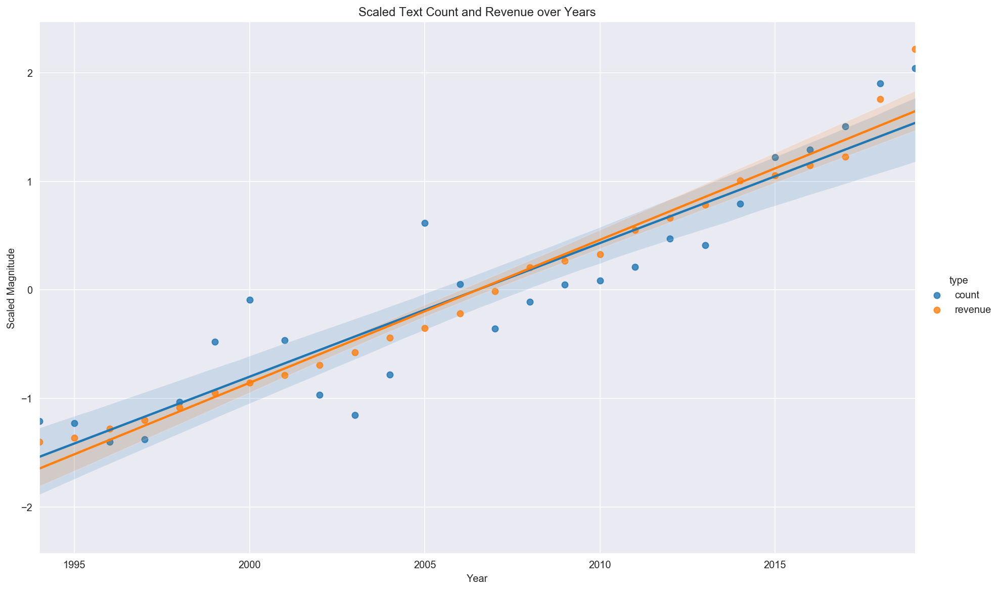

In [55]:
# scale the two parameters in order to make fair comparisions 

from sklearn.preprocessing import StandardScaler

scaler = StandardScaler()

merged_scaled = pd.DataFrame(scaler.fit_transform(merged_data[['count', 'revenue']]), 
                             columns=['count', 'revenue'])
merged_scaled = pd.concat([merged_data.year, merged_scaled], axis=1)
merged_scaled = merged_scaled.melt(id_vars=['year'], var_name='type', value_name='scaled_value')


g = sns.lmplot(x='year', y='scaled_value', hue='type', data=merged_scaled, aspect=1.6, height=8)
g.set(xlabel='Year', ylabel='Scaled Magnitude', xlim=[1994, 2019],
       title='Scaled Text Count and Revenue over Years')

g.savefig("scaled_count_vs_revenue.png")
plt.show()

> ⚠ Do not throw your money into MSFT stock based on this. I will not be responsible for you to lose your BitCoin or family inheritance. The filing format may have been revised thoughout the years.

<img src="images//balok.jpg" />

In [56]:
# create a library using a list containing tuples of the filing and a dictionary containing meta tags
# this format is used because Spacy's NLP Pipe requies a tuple

library = [(filing, {'year': year}) for year, filing in dict(zip(all_years, all_filings)).items()]

# Enter spaCy

SpaCy contains a pre-trained model using Wikipedia documents. This is not ideal and will not be as precise as we want, however, it gives us a basis for a starting point. To get more accurate results, we can perform transfer learning. This will, however, require hundreds of thousands of examples which are labeled.

In [57]:
# Import spaCy model
import spacy

# Import the English language class
from spacy.lang.en import English
from spacy.pipeline import EntityRuler

# Import Matcher and PhraseMatcher
from spacy.matcher import Matcher
from spacy.matcher import PhraseMatcher

# Import the Doc and Span class
from spacy.tokens import Doc, Span

# load english model
nlp = spacy.load('en_core_web_lg')
matcher = Matcher(nlp.vocab)
ruler = EntityRuler(nlp)

In [58]:
# checking out the spaCy pipeline

print(nlp.pipe_names)
print(nlp.pipeline)

['tagger', 'parser', 'ner']
[('tagger', <spacy.pipeline.pipes.Tagger object at 0x00000158986C1DA0>), ('parser', <spacy.pipeline.pipes.DependencyParser object at 0x0000015833A77888>), ('ner', <spacy.pipeline.pipes.EntityRecognizer object at 0x0000015833A778E8>)]


In [59]:
# extract the year

entities = {}

for doc, context in nlp.pipe(library, as_tuples=True):
    for year in context.values():
       entities[year] = doc

## Spacy Entities

In [60]:
# extract the entities within each filing into a dataframe for analysis

entities_list = []

for year in entities.keys():
       entities_list.append(pd.DataFrame([(ent.text, ent.label_, int(year)) for ent in entities[year].ents],
            columns=['entity', 'type', 'year']))
entities_df = pd.concat(entities_list)

### Entity Types

In [61]:
# the types of entities within the document

print(entities_df.type.unique())

['CARDINAL' 'ORG' 'DATE' 'GPE' 'LOC' 'PERSON' 'PRODUCT' 'ORDINAL' 'NORP'
 'WORK_OF_ART' 'LANGUAGE' 'MONEY' 'TIME' 'PERCENT' 'QUANTITY' 'EVENT'
 'FAC' 'LAW']


### Filing Years

In [62]:
# the filing years within our library

filing_years = entities_df.year.unique()
print(filing_years)

[1994 1995 1996 1997 1998 1999 2000 2001 2002 2003 2004 2005 2006 2007
 2008 2009 2010 2011 2012 2013 2014 2015 2016 2017 2018 2019]


In [63]:
entities_df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 21888 entries, 0 to 871
Data columns (total 3 columns):
entity    21888 non-null object
type      21888 non-null object
year      21888 non-null int64
dtypes: int64(1), object(2)
memory usage: 684.0+ KB


In [64]:
# export the results 
# sometimes the notebook resets the kernel and clears the memory

entities_df.to_csv('entities.csv', index=False)
entities_df[entities_df.type == 'ORG'].to_csv('orgs.csv', index=False)
entities_df[entities_df.type == 'PRODUCT'].to_csv('products.csv', index=False)

# Cleaning

In [65]:
# custom cleaning

stop_orgs = ['Company']

def filter_text(text):
   
    # second, apply word_tokenizer from nltk
    tokenized = word_tokenize(text)
    
    # lemmatize and remove stopwords and punctuations and numbers
    cleaned = [word
               for word in tokenized 
               if (word not in all_stopwords) & 
                   (word not in all_symbols) & 
                   (word not in stop_orgs) &
                   (word.isalpha())]
    
    return ' '.join(cleaned)

In [66]:
# group organzation by year and entity and count
# we will use this to plot a network graph

org_by_year_df = entities_df[entities_df.type == 'ORG']
org_by_year_df['entity'] = org_by_year_df['entity'].apply(lambda x: filter_text(x))
org_by_year_df = org_by_year_df[org_by_year_df.entity != ""]

print(org_by_year_df.head(10))

org_by_year_group = org_by_year_df.groupby(['year','entity'])\
    .count()\
    .sort_values(['year','type'], ascending=False)

print(org_by_year_group.head(10))

C:\Users\ksanv\.conda\envs\py3_env\lib\site-packages\ipykernel_launcher.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  """
                                     entity type  year
4                     Microsoft Corporation  ORG  1994
6                                 Microsoft  ORG  1994
11                                Microsoft  ORG  1994
14                           Products Group  ORG  1994
15                      Sales Support Group  ORG  1994
16                         Operations Group  ORG  1994
17                       The Products Group  ORG  1994
19  The Personal Operating Systems Division  ORG  1994
20            The Business Systems Division  ORG  1994
21        The Desktop Applications Division  ORG  1994
                type
year entity        

## Visual Exploration
Plotting all the dataset is not appropriate since we have such a large dataset.

In [67]:
import networkx as nx

G = nx.Graph()

# year as nodes
G.add_nodes_from(list(org_by_year_group.index.levels[0]))

# FUTURE: merge company that spans across years
# edge year---company
G.add_edges_from(set(list(org_by_year_group.index.values)))

### Network Graph

C:\Users\ksanv\.conda\envs\py3_env\lib\site-packages\networkx\drawing\nx_pylab.py:579: MatplotlibDeprecationWarning: 
The iterable function was deprecated in Matplotlib 3.1 and will be removed in 3.3. Use np.iterable instead.
  if not cb.iterable(width):


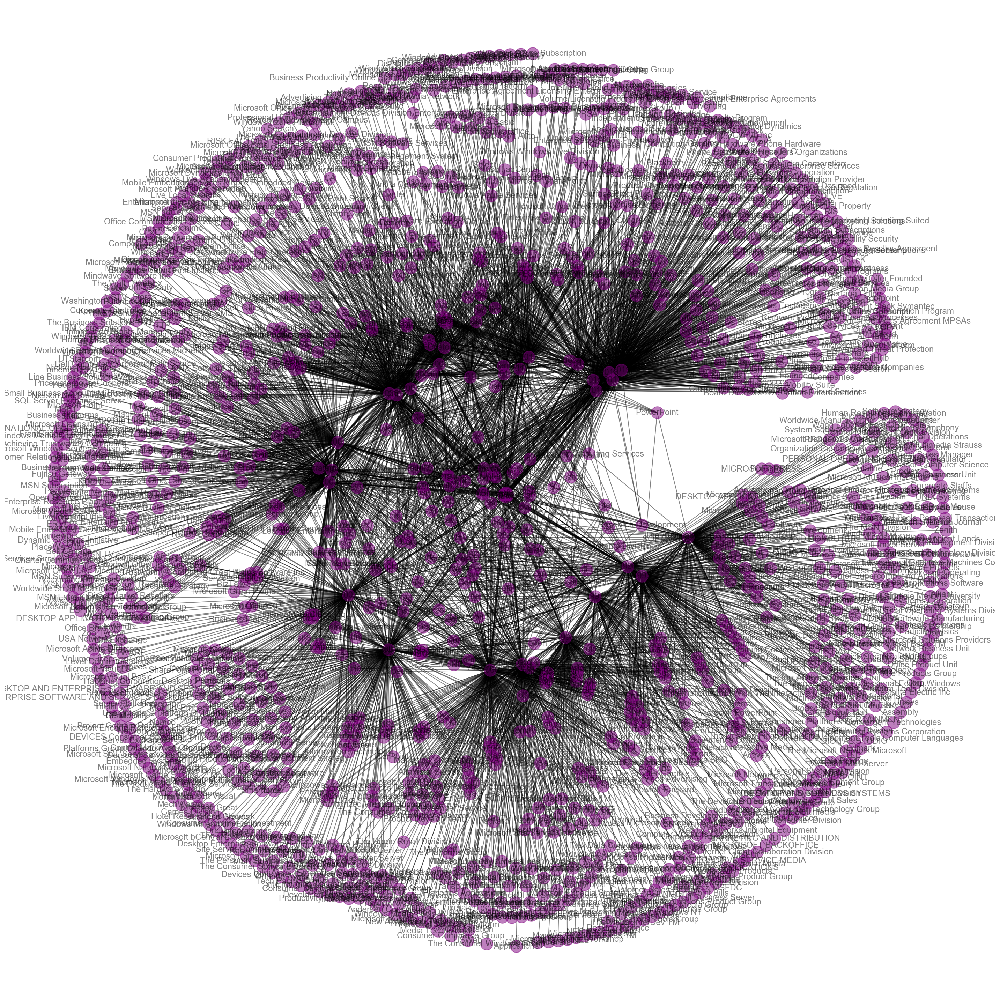

In [68]:
# Draw graph
fig, ax = plt.subplots(figsize=(20,20))
nx.draw_kamada_kawai(G, with_labels=True, node_color='#7f007f', alpha=.5)
plt.tight_layout()
plt.savefig("networkx_kamada_kawai.png", format="PNG")
plt.show()

In [69]:
spacy_orgs = pd.read_csv('orgs.csv')
spacy_orgs['entity'] = spacy_orgs['entity'].apply(lambda x: filter_text(x))
spacy_orgs = spacy_orgs[spacy_orgs.entity != ""].reset_index(drop=True)

## Tabular View

In [70]:
cm = sns.light_palette("green", as_cmap=True)

# view in tabular form across years
pd.options.display.max_columns = None
pd.options.display.max_rows = None
orgs_crosstab = pd.crosstab(spacy_orgs['year'], spacy_orgs['entity'])
display(orgs_crosstab.style.background_gradient(cmap=cm))

### Smaller Chunks
Show entities that were mentioned more than once.

In [71]:
# organization, products, keywords mentioned more than one times 

orgs_gt3_df = org_by_year_group[org_by_year_group.type.values > 1]

#### Timeline

In [72]:
orgs_gt3_df.T.style.background_gradient(cmap=cm)

> _blank entities indicate Stop Terms_

## Network Mapping
Terms mentioned more than 1 time

In [73]:
# wikipedia
import wikipedia as wiki

In [76]:
# create aggregate dataframe
elements = spacy_orgs.groupby(['year', 'entity']).entity.agg('count').to_frame('mentions').reset_index()
elements = elements[['entity', 'year', 'mentions']]

# use a smaller subset due to API limits
elements = elements[elements.mentions > 1]

# create year nodes
unique_years = pd.DataFrame(dict(labels = list(elements['year'].unique())))
unique_years['type'] = 'year'
unique_years['size'] = 1

# create key terms nodes
elements_kumu = elements[['entity', 'mentions']]
elements_kumu['type'] = 'ORG'
elements_kumu = elements_kumu[['entity', 'type', 'mentions']]
elements_kumu.columns = ['label', 'type', 'size']

for index, row in elements_kumu.iterrows():
    
        
    try:

        elements_kumu.set_value(index , 'summary', wiki.summary(row['label']))

    except:

        elements_kumu.set_value(index , 'summary', '')
        
# join the nodes
elements_kumu.append(unique_years)


# create connections
connections_kumu = elements[['year', 'entity']]
connections_kumu.columns = ['from', 'to']

C:\Users\ksanv\.conda\envs\py3_env\lib\site-packages\ipykernel_launcher.py:24: FutureWarning: set_value is deprecated and will be removed in a future release. Please use .at[] or .iat[] accessors instead
C:\Users\ksanv\.conda\envs\py3_env\lib\site-packages\wikipedia\wikipedia.py:389: UserWarning: No parser was explicitly specified, so I'm using the best available HTML parser for this system ("lxml"). This usually isn't a problem, but if you run this code on another system, or in a different virtual environment, it may use a different parser and behave differently.

The code that caused this warning is on line 389 of the file C:\Users\ksanv\.conda\envs\py3_env\lib\site-packages\wikipedia\wikipedia.py. To get rid of this warning, pass the additional argument 'features="lxml"' to the BeautifulSoup constructor.

  lis = BeautifulSoup(html).find_all('li')
C:\Users\ksanv\.conda\envs\py3_env\lib\site-packages\ipykernel_launcher.py:28: FutureWarning: set_value is deprecated and will be removed

In [77]:
elements_kumu.to_csv('elements.csv', index=False)
connections_kumu.to_csv('collections.csv', index=False)

In [78]:
# years color palette
yrs_palette = sns.color_palette("husl", 26).as_hex()
print(', '.join(yrs_palette))

#f77189, #f77461, #eb8032, #d38d32, #c19632, #b19c32, #a0a131, #8da631, #71ac31, #31b332, #33b16f, #34af87, #35ae97, #36ada4, #36abb0, #37aabd, #39a8cc, #3aa5e2, #639df4, #9292f4, #b486f4, #d276f4, #f35cf4, #f563d7, #f668be, #f66da6


In [79]:
%%HTML
<iframe
  src="https://embed.kumu.io/87ecfa8029bb2c3dd4aa096abc7ed6b3"
  width="100%" height="1000" frameborder="0"></iframe>


In [80]:
len(list(orgs_gt3_df.type.unstack())), len(list(orgs_gt3_df.index.levels[0])), len(list((orgs_gt3_df.type.values)))

(392, 26, 1385)

# Enter GenSim

In [81]:
minlibrary = {}

for filing in library:
    minlibrary[filing[1]['year']] = word_tokenize(filter_text(filing[0]))

## Bag of Words

In [82]:
from gensim.corpora.dictionary import Dictionary

gensim_dict = {}
gensim_corpus = {}

# dictionary requires tokenized inputs
for year, filing in minlibrary.items():
    
    gensim_dict[year] = Dictionary([filing])
    gensim_corpus[year] = gensim_dict[year].doc2bow(filing)


###  Testing filing from single year

In [83]:
# list of words and their ids
list(gensim_dict['1994'].token2id.items())[:10]

[('A', 0),
 ('ACCOUNTS', 1),
 ('ADVERTISING', 2),
 ('AGE', 3),
 ('AND', 4),
 ('APPLICATIONS', 5),
 ('AST', 6),
 ('AT', 7),
 ('Access', 8),
 ('Additionally', 9)]

In [84]:
# finding the id from string
microsoft_id = gensim_dict['1994'].token2id.get('microsoft')


# finding string from id
token_id = gensim_dict['1994'].get(microsoft_id)
token_id

print(f'ID: {microsoft_id}\nTOKEN: {token_id}')

ID: None
TOKEN: None


In [85]:
# sort the filing for frequency
bow_filing = sorted(gensim_corpus['1994'], key=op.itemgetter(1), reverse=True)

for word_id, word_count in bow_filing[:50]:
    print(gensim_dict['1994'].get(word_id), word_count)

Microsoft180
The111
President80
Vice76
products65
Windows54
software49
operating37
support31
Division28
applications28
development28
product28
systems28
business27
named25
users23
Systems21
He20
Senior20
marketing19
provides19
Manager18
information18
end17
joined17
OEMs16
sales16
Business15
Macintosh15
include15
General14
NT14
R14
Software14
database14
large14
program14
user14
OEM13
PAGE13
Sales13
including13
office13
programs13
use13
In12
PCs12
Support12
TM12


### BOW across all filings

In [87]:
from collections import defaultdict
import itertools

# default dict with int arg
total_word_count = defaultdict(int)

all_corpus = [corpus for year, corpus in gensim_corpus.items()]
all_dict = Dictionary(minlibrary.values())
    
for word_id, word_count in itertools.chain.from_iterable(all_corpus):
       
    total_word_count[word_id] += word_count

# Create a sorted list from the defaultdict: sorted_word_count
sorted_word_count = sorted(total_word_count.items(), key=lambda v: v[1], reverse=True) 

# Print the top 5 words across all documents alongside the count
for word_id, word_count in sorted_word_count[:50]:
    print(all_dict.get(word_id), word_count)

System331
thousands326
Murray320
MANAGER315
North287
VAX284
Microsoft277
toll266
Thus261
Lazarus257
supported255
Mozart247
LEGAL244
Vice241
Kids232
MARKETING231
total230
Sidewinder229
Network228
Wang228
Also227
Micro226
R224
PROPERTIES223
TM222
Those217
Under216
Kingdom211
Security210
Special210
Operation209
Mellon208
Olivetti207
To206
Broadcast206
Networks204
Providers204
mainframes204
Strategic203
WORK200
Cruz199
opportunities196
vote195
Windows194
content194
midrange193
Area190
Sun187
aesthetic187
specific187


> _Results aren't great..._ 
 - _We can limit the scope of the corpora by using rule-based document sectioning, i.e., using text from ITEM I of the filing only._
 - _We can try TF-IDF_


## TF-IDF

In [88]:
from gensim.models.tfidfmodel import TfidfModel

tfidf = TfidfModel(all_corpus)

for year, filing in gensim_corpus.items():
    tfidf_weights = tfidf[filing]
    
sorted_tfidf_weights = sorted(tfidf_weights, key=lambda v: v[1], reverse=True)



for word_id, weight in sorted_tfidf_weights[:50]:
    print(all_dict.get(word_id), '\t' ,weight)

Area0.6104806250366893
InterDev0.2970464105524748
opportunities0.25551870096717066
jointly0.1945487706160878
Hasbro0.17743017052467308
Investments0.16699310167028056
terminals0.16436016827910865
Express0.15613977990578803
issues0.14611896396149548
MSFDC0.11805690675803485
expand0.11423341149167268
IntelliSense0.10958922297112161
investor0.10437068854392535
Lozano0.09393361968953282
educators0.09226544774327411
hotel0.09056580701093743
present0.09056580701093743
aid0.08617416001502383
players0.08349655083514028
purchasing0.08349655083514028
Localizing0.08349655083514028
directions0.07379436126817124
MCPs0.07305948198074774
VHC0.07291659693578939
daily0.070440072119618
center0.07029748399487551
ROMs0.06628781539617218
widely0.06490782079971293
ActiMates0.06373149382251152
going0.0626224131263552
satellite0.06259371483252443
numbers0.061254483108568306
Portal0.05965903385655496
Nevada0.057124309721629775
Workshop0.05711670574583634
Given0.05371681721355553
mutual0.05366862637685181
Intell